In [1]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

In [2]:
# Paths
images_folder = "../dataset_portion/images/"  # Folder with original images
labels_folder = "../dataset_portion/labels/"  # Folder containing YOLO label files
masks_folder = "../dataset_portion/masks/"    # Where to save precise masks

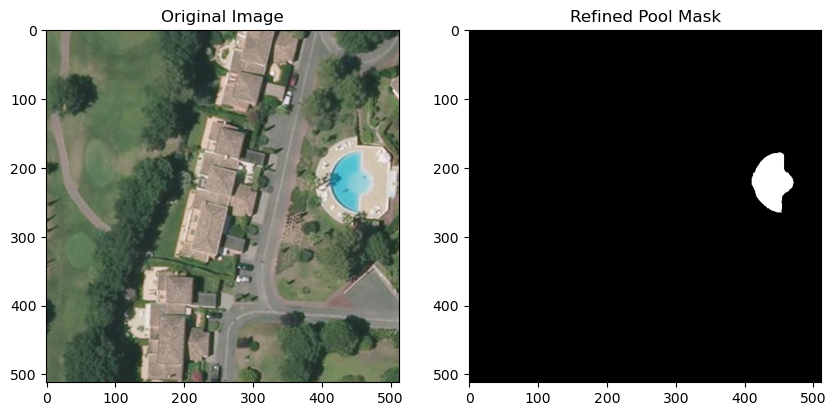

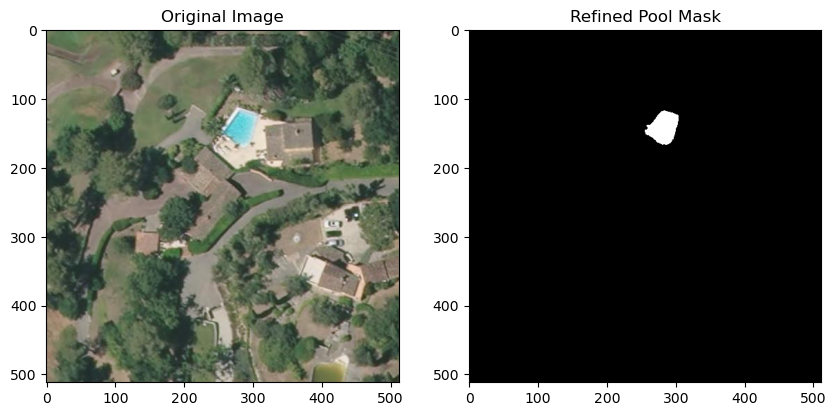

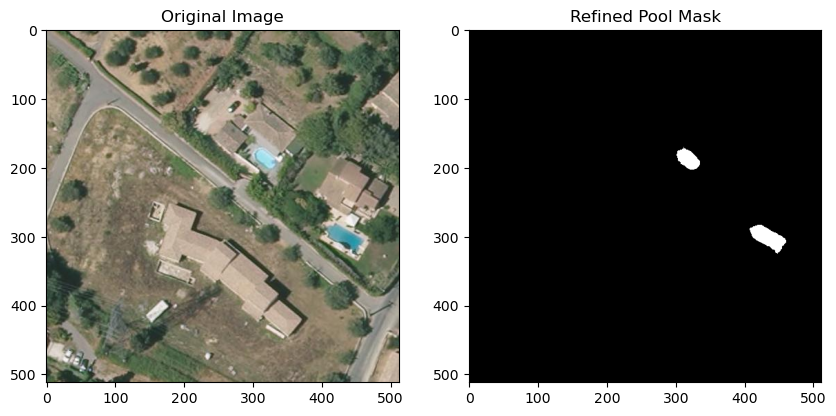

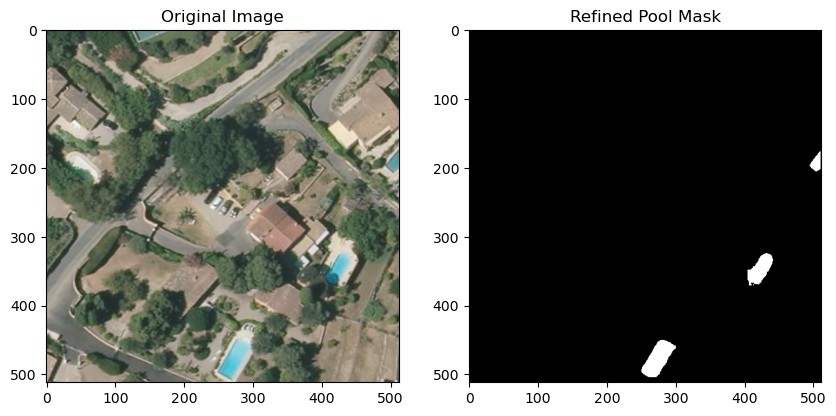

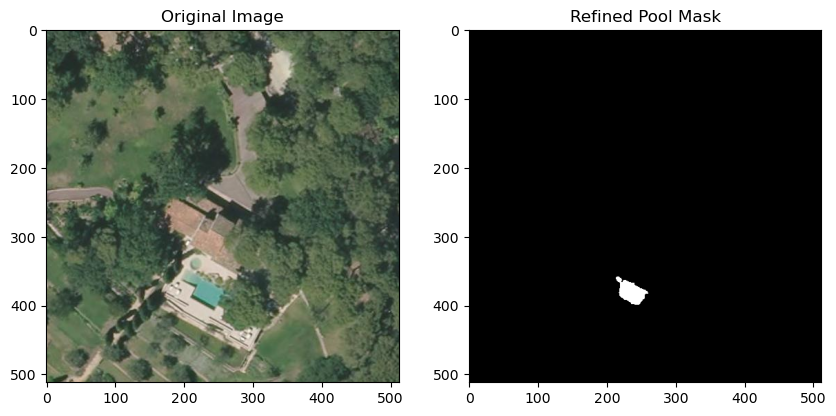

...

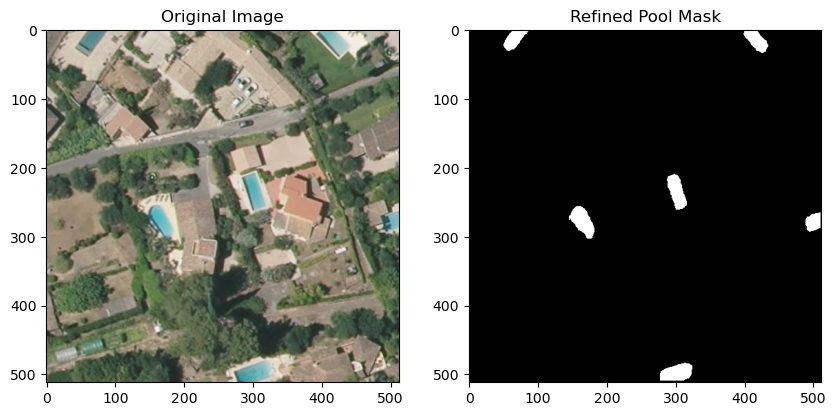

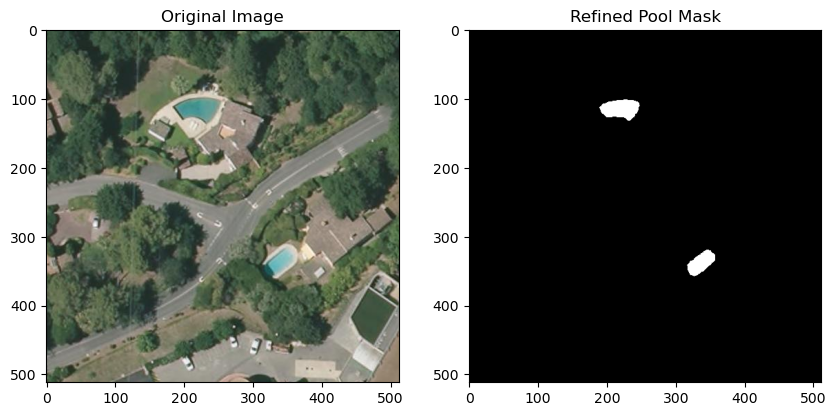

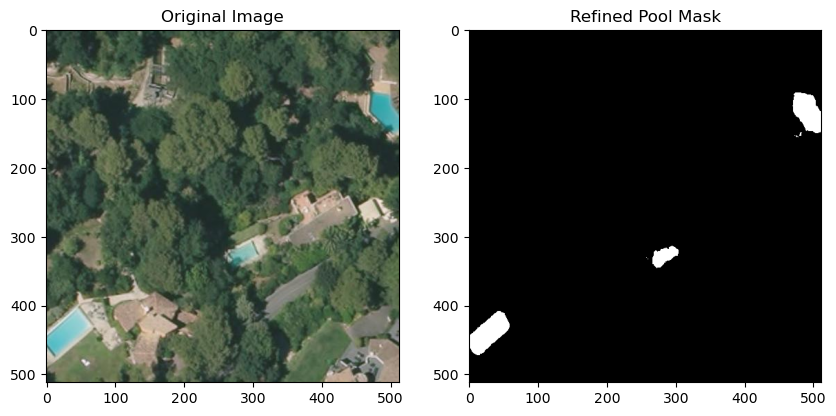

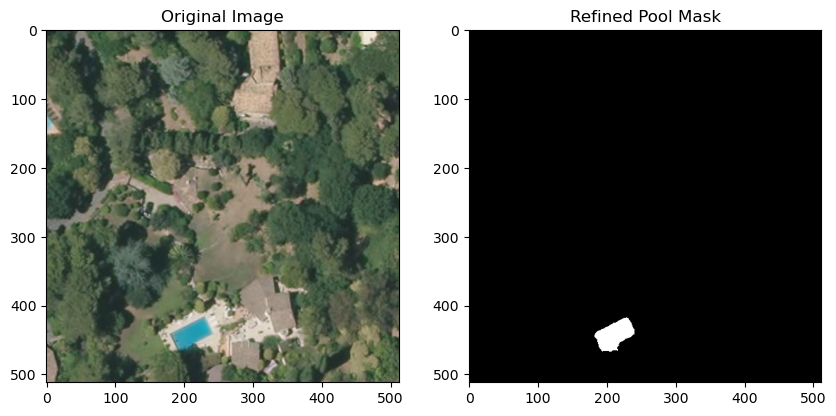

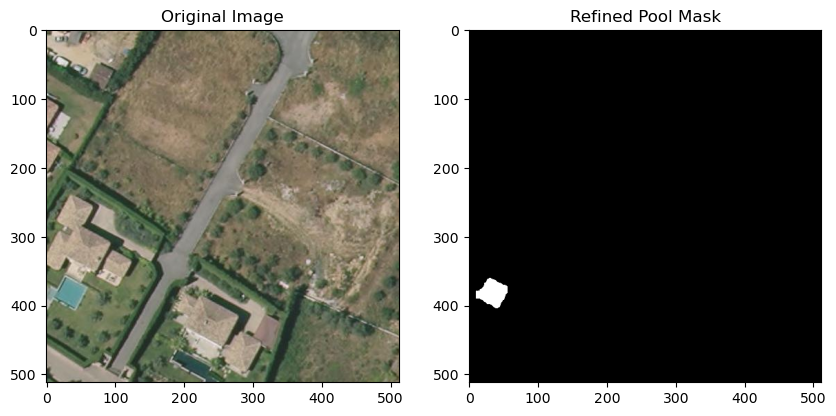

✅ Pool masks generated using YOLO + Color Segmentation!


In [3]:
os.makedirs(masks_folder, exist_ok=True)

image_files = [f for f in os.listdir(images_folder) if f.endswith(".jpg")]

for image_file in image_files:
    image_path = os.path.join(images_folder, image_file)
    label_path = os.path.join(labels_folder, image_file.replace(".jpg", ".txt"))

    # Load the image
    image = cv2.imread(image_path)
    h, w, _ = image.shape
    
    # Create an empty black mask
    precise_mask = np.zeros((h, w), dtype=np.uint8)

    # Load YOLO labels
    if os.path.exists(label_path):
        with open(label_path, "r") as file:
            lines = file.readlines()

        for line in lines:
            data = line.strip().split()
            class_id, x_center, y_center, bbox_width, bbox_height = map(float, data)

            # Convert YOLO format (normalized) to pixel values
            x_center, y_center = int(x_center * w), int(y_center * h)
            bbox_width, bbox_height = int(bbox_width * w), int(bbox_height * h)
            
            # Get bounding box coordinates
            x1, y1 = x_center - bbox_width // 2, y_center - bbox_height // 2
            x2, y2 = x_center + bbox_width // 2, y_center + bbox_height // 2

            # Extract region of interest (ROI)
            roi = image[y1:y2, x1:x2]

            # Convert to HSV
            hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)

            # Define blue color range for pool detection
            lower_blue = np.array([80, 30, 70])
            upper_blue = np.array([130, 255, 255])

            # Create mask for blue regions
            mask = cv2.inRange(hsv_roi, lower_blue, upper_blue)

            # Find contours within the cropped region
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            for contour in contours:
                # Offset contour coordinates to match the full image
                contour += np.array([[x1, y1]])

                # Draw and fill the contour on the precise mask
                cv2.drawContours(precise_mask, [contour], -1, 255, thickness=cv2.FILLED)

    # Save the final mask
    mask_path = os.path.join(masks_folder, image_file.replace(".jpg", ".png"))
    cv2.imwrite(mask_path, precise_mask)

    # Optional: Show results
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Original Image")

    plt.subplot(1, 2, 2)
    plt.imshow(precise_mask, cmap="gray")
    plt.title("Refined Pool Mask")

    plt.show()

print("✅ Pool masks generated using YOLO + Color Segmentation!")


## larger data

In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

# Paths
images_folder = "Training Model/dataset/images/"  # Folder with original images
labels_folder = "Training Model/dataset/labels/"  # Folder containing YOLO label files
masks_folder = "Training Model/dataset/masks/"    # Where to save precise masks

os.makedirs(masks_folder, exist_ok=True)

image_files = [f for f in os.listdir(images_folder) if f.endswith(".jpg")]

# Define batch size
batch_size = 100  # Adjust batch size based on available memory

def process_image(image_file):
    try:
        image_path = os.path.join(images_folder, image_file)
        label_path = os.path.join(labels_folder, image_file.replace(".jpg", ".txt"))

        # Load the image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Skipping corrupted image: {image_file}")
            return

        h, w, _ = image.shape
        
        # Create an empty black mask
        precise_mask = np.zeros((h, w), dtype=np.uint8)

        # Load YOLO labels
        if os.path.exists(label_path):
            with open(label_path, "r") as file:
                lines = file.readlines()

            for line in lines:
                data = line.strip().split()
                class_id, x_center, y_center, bbox_width, bbox_height = map(float, data)

                # Convert YOLO format (normalized) to pixel values
                x_center, y_center = int(x_center * w), int(y_center * h)
                bbox_width, bbox_height = int(bbox_width * w), int(bbox_height * h)
                
                # Get bounding box coordinates
                x1, y1 = x_center - bbox_width // 2, y_center - bbox_height // 2
                x2, y2 = x_center + bbox_width // 2, y_center + bbox_height // 2

                # Extract region of interest (ROI)
                roi = image[y1:y2, x1:x2]

                # Convert to HSV
                hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)

                # Define blue color range for pool detection
                lower_blue = np.array([80, 30, 70])
                upper_blue = np.array([130, 255, 255])

                # Create mask for blue regions
                mask = cv2.inRange(hsv_roi, lower_blue, upper_blue)

                # Find contours within the cropped region
                contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

                for contour in contours:
                    # Offset contour coordinates to match the full image
                    contour += np.array([[x1, y1]])

                    # Draw and fill the contour on the precise mask
                    cv2.drawContours(precise_mask, [contour], -1, 255, thickness=cv2.FILLED)

        # Save the final mask
        mask_path = os.path.join(masks_folder, image_file.replace(".jpg", ".png"))
        cv2.imwrite(mask_path, precise_mask)

    except Exception as e:
        print(f"Error processing image {image_file}: {e}")

# Process in batches
for i in range(0, len(image_files), batch_size):
    batch = image_files[i:i + batch_size]
    for image_file in batch:
        process_image(image_file)

print("✅ Pool masks generated using YOLO + Color Segmentation!")

